In [1]:
import numpy as np
from basicpy import BaSiC
from scipy.ndimage import zoom
import zarr
from numcodecs import GZip 

from matplotlib import pyplot as plt
import seaborn as sns

In [2]:
def transform(images, f, d=None):
    if d is not None:
        images_transformed = (np.clip(images-d[np.newaxis],0,None))/f[np.newaxis]
    else:
        images_transformed = images/f[np.newaxis]
        
    return images_transformed

In [3]:
path = "/u/scratch/f/f7xiesnm/sparse06/dataset.n5"
outpath = "/u/home/f/f7xiesnm/project-zipursky/data/hold/sparse06/r1_test_flatfield_v6.n5"
zarr_data = zarr.open(store=zarr.N5Store(path), mode='r')

In [4]:
tileshape  = zarr_data[f'/setup13/timepoint0/s4'].shape
tileshape0 = zarr_data[f'/setup13/timepoint0/s1'].shape
print(tileshape, tileshape0)

(354, 120, 120) (2837, 960, 960)


In [5]:
images = zarr_data[f'/setup13/timepoint0/s4'][...]

# cnst = 88
# images = np.clip(images.astype(np.float16) - cnst, 0, 1000).astype(np.uint16)

In [6]:
# import tifffile
# outdir = '/u/home/f/f7xiesnm/project-zipursky/easifish/results/viz_sparse06_v2'
# !mkdir -p $outdir

# print(np.max(images), np.min(images))
# tifffile.imwrite(outdir+'/c0_s4.tiff', images)

# print(np.max(images_dapi), np.min(images_dapi))
# tifffile.imwrite(outdir+'/c3_s4.tiff', images_dapi)

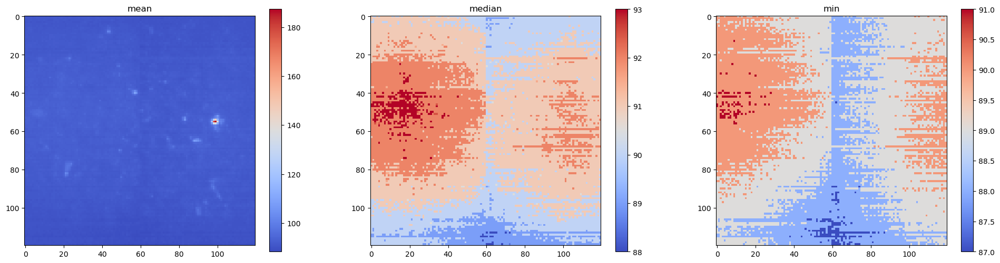

In [7]:
# plt.imshow(np.mean(images, axis=0), cmap='coolwarm')

fig, axs = plt.subplots(1,3, figsize=(3*8,6))
ax = axs[0]
g = ax.imshow(np.mean(images, axis=0), cmap='coolwarm')
ax.set_title('mean')
fig.colorbar(g)

ax = axs[1]
g = ax.imshow(np.median(images, axis=0), cmap='coolwarm')
ax.set_title('median')
fig.colorbar(g)

ax = axs[2]
g = ax.imshow(np.min(images, axis=0), cmap='coolwarm')
ax.set_title('min')
fig.colorbar(g)
plt.show()

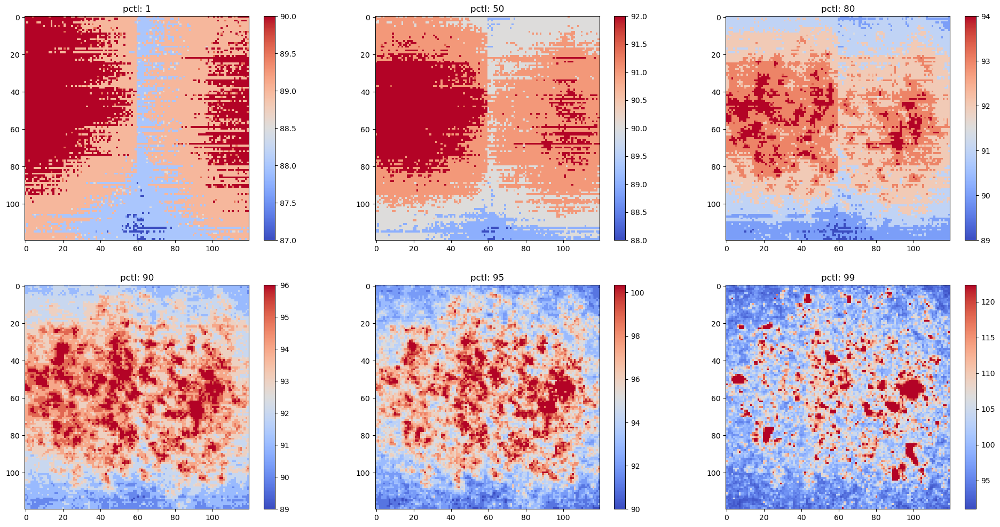

In [8]:
pctls = [1, 50, 80, 90, 95, 99]
fig, axs = plt.subplots(2,3, figsize=(3*8,2*6))
for ax, pctl in zip(axs.flat, pctls): 
    vec = np.percentile(images, pctl, axis=0)
    vmax = np.percentile(vec, 95)
    vmin = np.percentile(vec,  5)
    g = ax.imshow(vec, cmap='coolwarm', vmax=vmax)
    ax.set_title(f'pctl: {pctl}')
    fig.colorbar(g)

plt.show()

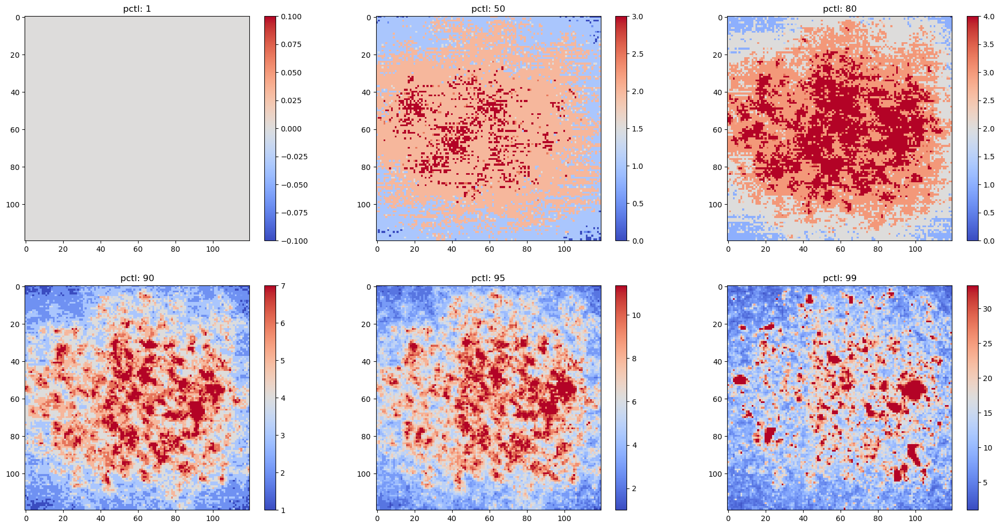

In [9]:
vec0 = np.percentile(images, 1, axis=0)

pctls = [1, 50, 80, 90, 95, 99]
fig, axs = plt.subplots(2,3, figsize=(3*8,2*6))
for ax, pctl in zip(axs.flat, pctls): 
    vec = np.percentile(images, pctl, axis=0) - vec0
    vmax = np.percentile(vec, 95)
    vmin = np.percentile(vec,  5)
    g = ax.imshow(vec, cmap='coolwarm', vmax=vmax)
    ax.set_title(f'pctl: {pctl}')
    fig.colorbar(g)

plt.show()

In [10]:
images_s3 = zarr_data[f'/setup13/timepoint0/s3'][...]

In [11]:
pctls = [1, 50, 80, 90, 95, 99]
vects3 = []
for pctl in pctls:
    vec = np.percentile(images_s3, pctl, axis=0)
    vects3.append(vec)

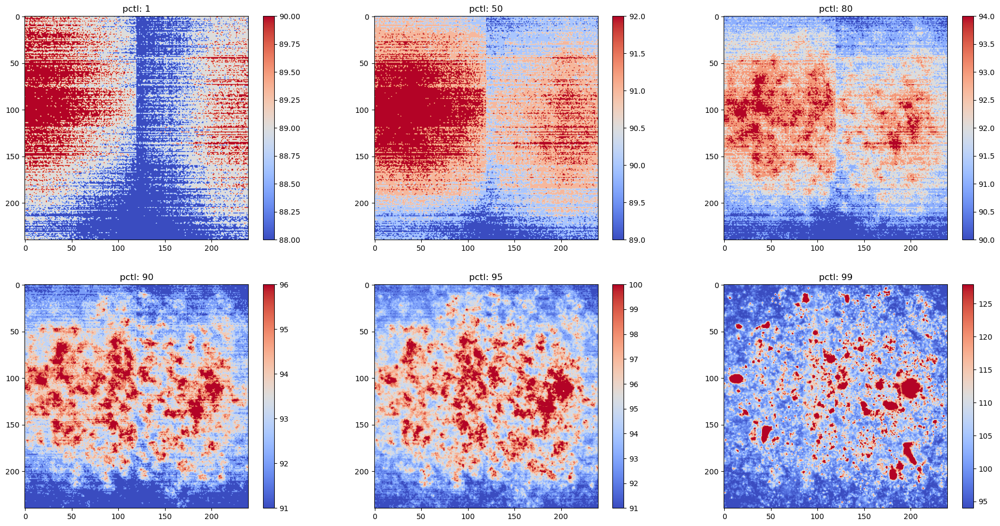

In [12]:
fig, axs = plt.subplots(2,3, figsize=(3*8,2*6))
for ax, pctl, vec in zip(axs.flat, pctls, vects3): 
    vmax = np.percentile(vec, 95)
    vmin = np.percentile(vec,  5)
    
    g = ax.imshow(vec, cmap='coolwarm', vmax=vmax, vmin=vmin) #, interpolation='nearest')
    ax.set_title(f'pctl: {pctl}')
    fig.colorbar(g)

plt.show()

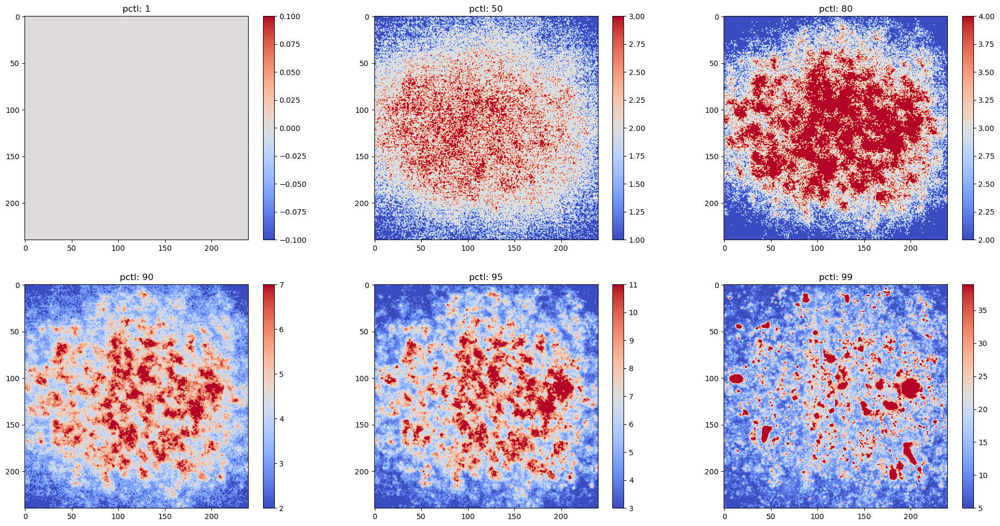

In [13]:
fig, axs = plt.subplots(2,3, figsize=(3*8,2*6))
for ax, pctl, vec in zip(axs.flat, pctls, vects3): 
    vec = vec - vects3[0]
    vmax = np.percentile(vec, 95)
    vmin = np.percentile(vec,  5)
    
    g = ax.imshow(vec, cmap='coolwarm', vmax=vmax, vmin=vmin) #, interpolation='nearest')
    ax.set_title(f'pctl: {pctl}')
    fig.colorbar(g)

plt.show()

In [14]:
images_s2 = zarr_data[f'/setup13/timepoint0/s2'][...]

In [15]:
pctls = [1, 50, 80, 90, 95, 99]
vects2 = []
for pctl in pctls:
    vec = np.percentile(images_s2, pctl, axis=0)
    vects2.append(vec)

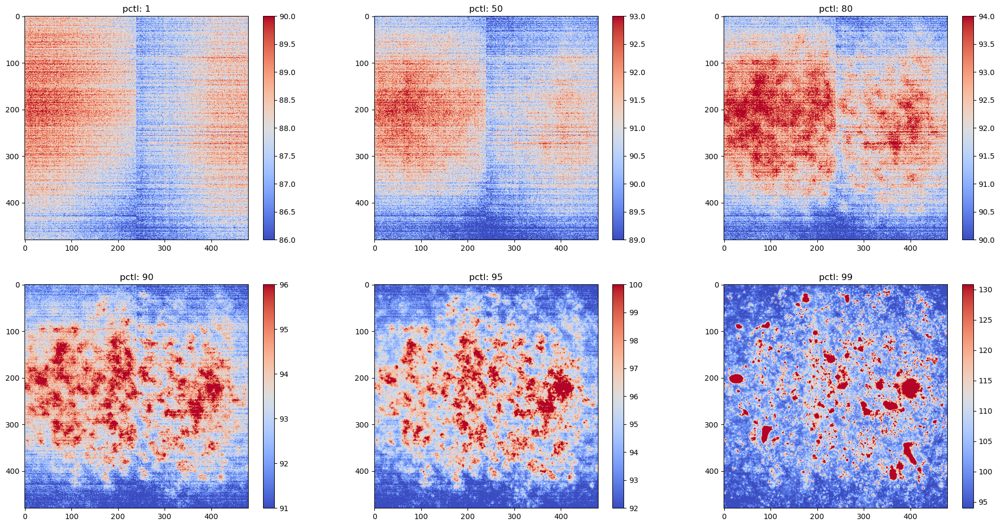

In [16]:
fig, axs = plt.subplots(2,3, figsize=(3*8,2*6))
for ax, pctl, vec in zip(axs.flat, pctls, vects2): 
    vmax = np.percentile(vec, 95)
    vmin = np.percentile(vec,  5)
    
    g = ax.imshow(vec, cmap='coolwarm', vmax=vmax, vmin=vmin) #, interpolation='nearest')
    ax.set_title(f'pctl: {pctl}')
    fig.colorbar(g)

plt.show()

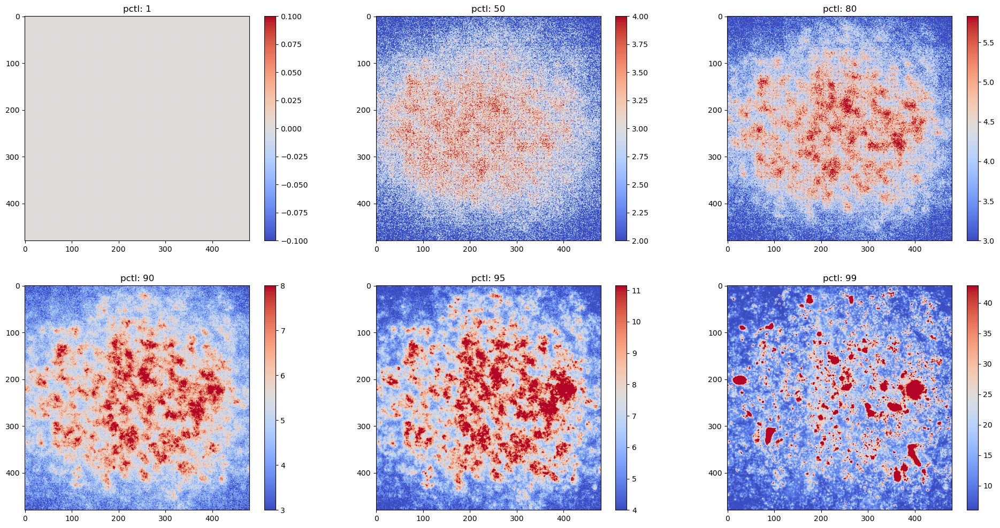

In [17]:
fig, axs = plt.subplots(2,3, figsize=(3*8,2*6))
for ax, pctl, vec in zip(axs.flat, pctls, vects2): 
    vec = vec - vects2[0]
    vmax = np.percentile(vec, 95)
    vmin = np.percentile(vec,  5)
    
    g = ax.imshow(vec, cmap='coolwarm', vmax=vmax, vmin=vmin) #, interpolation='nearest')
    ax.set_title(f'pctl: {pctl}')
    fig.colorbar(g)

plt.show()

In [18]:
images_s1 = zarr_data[f'/setup13/timepoint0/s1'][...]

In [19]:
pctls = [1, 50, 80, 90, 95, 99]
vects = []
for pctl in pctls:
    vec = np.percentile(images_s1, pctl, axis=0)
    vects.append(vec)

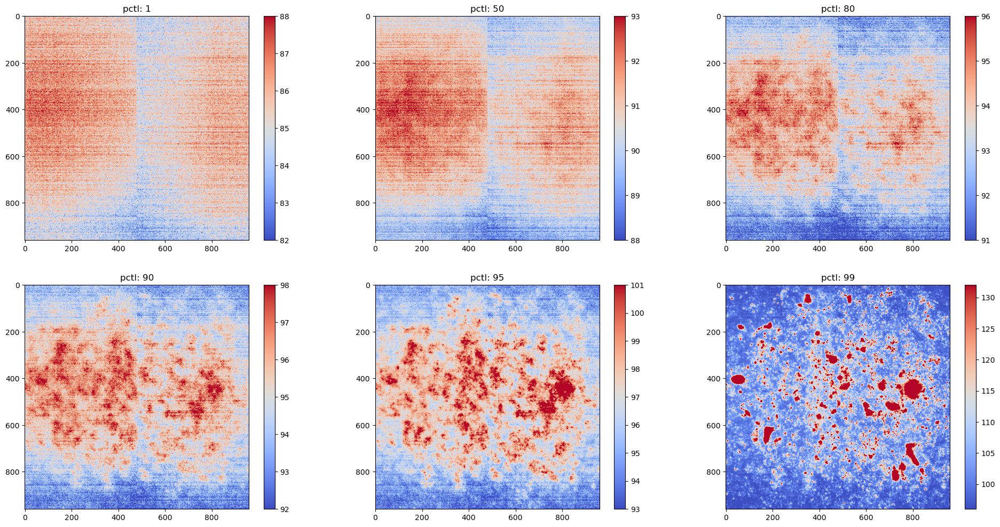

In [20]:
fig, axs = plt.subplots(2,3, figsize=(3*8,2*6))
for ax, pctl, vec in zip(axs.flat, pctls, vects): 
    vmax = np.percentile(vec, 95)
    vmin = np.percentile(vec,  5)
    
    g = ax.imshow(vec, cmap='coolwarm', vmax=vmax, vmin=vmin) #, interpolation='nearest')
    ax.set_title(f'pctl: {pctl}')
    fig.colorbar(g)

plt.show()

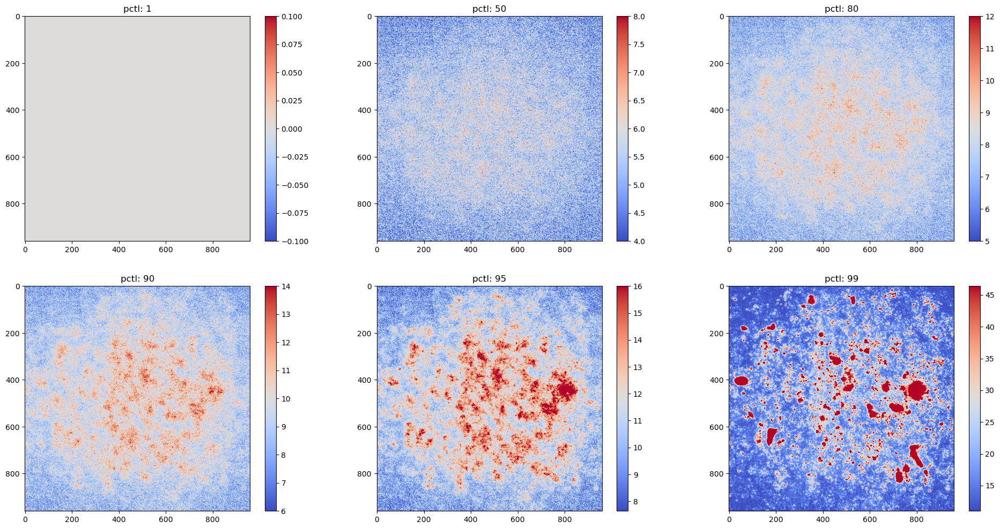

In [21]:
fig, axs = plt.subplots(2,3, figsize=(3*8,2*6))
for ax, pctl, vec in zip(axs.flat, pctls, vects): 
    vec = vec - vects[0]
    vmax = np.percentile(vec, 95)
    vmin = np.percentile(vec,  5)
    
    g = ax.imshow(vec, cmap='coolwarm', vmax=vmax, vmin=vmin) #, interpolation='nearest')
    ax.set_title(f'pctl: {pctl}')
    fig.colorbar(g)

plt.show()

In [6]:
images = zarr_data[f'/setup13/timepoint0/s4'][...]
dx = np.percentile(images,1, axis=0)
images = np.clip(images.astype(np.float16) - dx, 0, 1000).astype(np.uint16)

In [11]:
%%time
basic = BaSiC(get_darkfield=False, smoothness_flatfield=1)
basic.fit(images)

CPU times: user 38.3 s, sys: 1.15 s, total: 39.4 s
Wall time: 17.6 s


In [12]:
ff  = basic.flatfield
np.min(ff), np.max(ff)

(0.5092423, 1.3428628)

In [13]:
df  = basic.darkfield
np.min(df), np.max(df)

(0.0, 0.0)

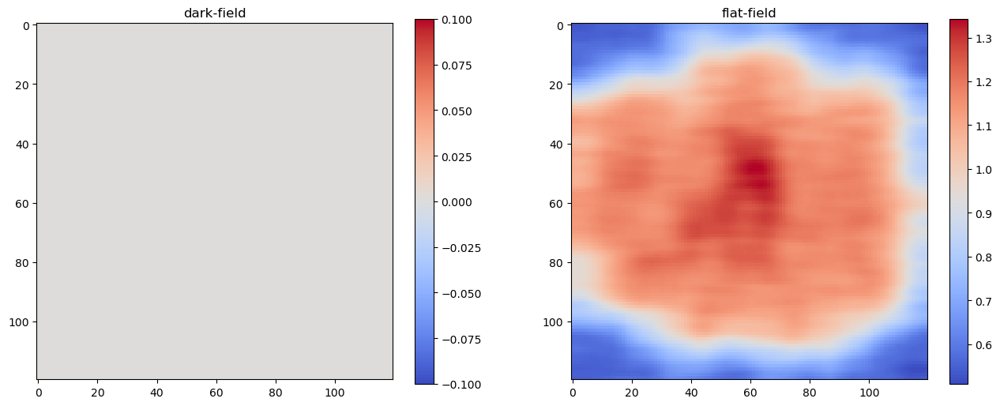

In [14]:
fig, axs = plt.subplots(1,2,figsize=(8*2, 6))

ax = axs[0]
g = ax.imshow(df, cmap='coolwarm') #, vmin=0, vmax=2)
ax.set_title('dark-field')
plt.colorbar(g)

ax = axs[1]
g = ax.imshow(ff, cmap='coolwarm',) # vmid=1) # vmin=0, vmax=2)
ax.set_title('flat-field')
fig.colorbar(g)

plt.show()


In [15]:
images_s1  = zarr_data[f'/setup13/timepoint0/s1'][...]
attributes = zarr_data[f'/setup13/timepoint0/s1'].attrs.asdict()
attributes['pixelResolution'] = [0.23, 0.23, 0.42] # useful later
attributes

{'downsamplingFactors': [2, 2, 1], 'pixelResolution': [0.23, 0.23, 0.42]}

In [26]:
np.min(ff_s1)

0.5087739

In [28]:
ff_s1 = zoom(basic.flatfield, 8)
dx_s1 = zoom(dx, 8)
# images_transformed    = transform(images   , basic.flatfield).astype(np.uint16)
images_transformed_s1 = transform(images_s1.astype(np.float16), ff_s1, d=dx_s1).astype(np.uint16)

In [29]:
# a0 = cnst + images_s1.astype(np.uint16)
# a  = cnst + images_transformed_s1.astype(np.uint16)
a  = images_transformed_s1.astype(np.uint16)
# a

array([[[ 5,  7,  0, ...,  0,  5, 15],
        [ 3,  7,  0, ...,  0, 15,  3],
        [ 1,  0,  5, ...,  7,  4,  2],
        ...,
        [ 0,  1, 10, ...,  0,  3,  5],
        [ 0,  0,  5, ...,  0,  7,  0],
        [ 0,  1,  5, ...,  5,  1,  0]],

       [[ 3,  0,  3, ..., 13,  7,  5],
        [ 0,  3,  1, ...,  0,  7,  1],
        [ 5, 15,  9, ...,  0,  9, 11],
        ...,
        [ 1,  7,  9, ...,  3,  0,  3],
        [ 5,  7,  1, ...,  0,  0,  0],
        [ 0,  0,  5, ...,  0,  0,  0]],

       [[ 1,  7,  7, ...,  0,  9, 15],
        [ 1,  1,  3, ...,  1,  9,  3],
        [ 3,  0,  1, ..., 11,  4, 17],
        ...,
        [ 5,  3,  0, ...,  3,  3, 13],
        [ 3,  5,  1, ...,  0,  0,  5],
        [ 0,  3,  3, ...,  0,  0,  0]],

       ...,

       [[ 1,  3,  3, ...,  0,  0,  9],
        [ 0,  9,  0, ...,  0,  5,  3],
        [ 1,  0,  3, ...,  2,  7,  4],
        ...,
        [ 0,  3,  0, ...,  0,  0,  0],
        [10,  0,  5, ...,  0,  0,  0],
        [ 0,  0,  0, ...,  0,  0

In [30]:
n5_root = zarr.open_group(store=zarr.N5Store(outpath), mode='w')

In [31]:
dataset = n5_root.require_dataset(
    'c0/s1',
    shape=a.shape,
    chunks=(64, 128, 128),
    dtype=a.dtype,
    compressor=GZip(level=1),
    data=a)
# set additional attributes
dataset.attrs.update(**attributes)

In [32]:
n5_root['c0/s1']

<zarr.core.Array '/c0/s1' (2837, 960, 960) uint16>

In [33]:
!ls $outpath
!cat $outpath/attributes.json
!cat $outpath/c0/s1/attributes.json

attributes.json  c0
{
    "n5": "2.0.0"
}{
    "blockSize": [
        128,
        128,
        64
    ],
    "compression": {
        "level": 1,
        "type": "gzip",
        "useZlib": false
    },
    "dataType": "uint16",
    "dimensions": [
        960,
        960,
        2837
    ],
    "downsamplingFactors": [
        2,
        2,
        1
    ],
    "pixelResolution": [
        0.23,
        0.23,
        0.42
    ]
}

In [44]:
img1 = n5_root['c0/s1'][...]
img2 = n5_root['c00/s1'][...]

NameError: name 'n5_root' is not defined

In [45]:
img1.shape, img2.shape

NameError: name 'img1' is not defined

In [18]:
import tifffile

outdir = '/u/home/f/f7xiesnm/project-zipursky/easifish/results/viz_sparse06_v2'
!mkdir -p $outdir

print(np.max(img1), np.min(img1))
tifffile.imwrite(outdir+'/c0_s1.tiff', img1)

outdir = '/u/home/f/f7xiesnm/project-zipursky/easifish/results/viz_sparse06_v2'
print(np.max(img2), np.min(img2))
tifffile.imwrite(outdir+'/c00_s1.tiff', img2)

65487 25
2546 90


In [38]:
# get adata attributes correct

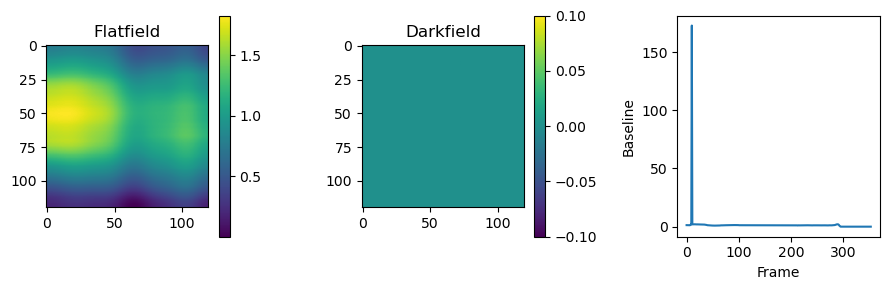

In [39]:
fig, axes = plt.subplots(1, 3, figsize=(9, 3))
im = axes[0].imshow(basic.flatfield)
fig.colorbar(im, ax=axes[0])
axes[0].set_title("Flatfield")
im = axes[1].imshow(basic.darkfield)
fig.colorbar(im, ax=axes[1])
axes[1].set_title("Darkfield")
axes[2].plot(basic.baseline)
axes[2].set_xlabel("Frame")
axes[2].set_ylabel("Baseline")
fig.tight_layout()

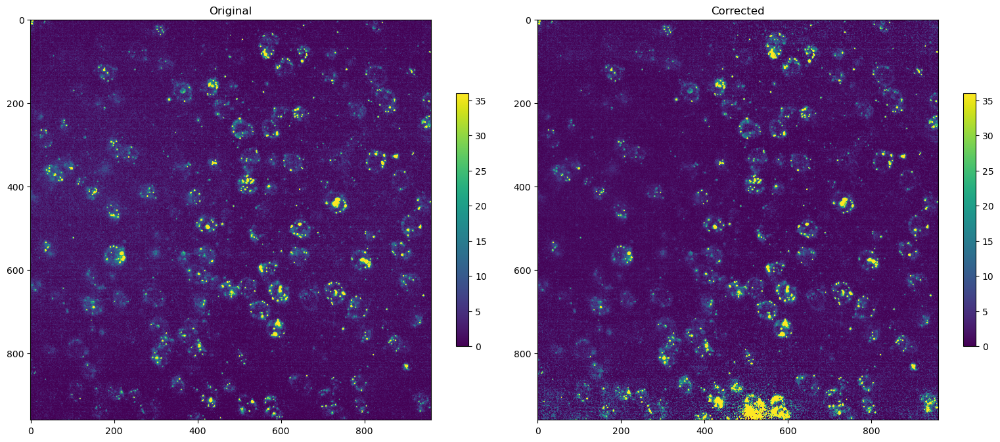

In [40]:
i = 100

vmin = np.percentile(images_transformed_s1[i], 5)
vmax = np.percentile(images_transformed_s1[i], 99)

fig, axes = plt.subplots(1, 2, figsize=(16,8))
im = axes[0].imshow(images_s1[i], vmin=vmin, vmax=vmax)
fig.colorbar(im, ax=axes[0], shrink=0.5)
axes[0].set_title("Original")
im = axes[1].imshow(images_transformed_s1[i], vmin=vmin, vmax=vmax)
fig.colorbar(im, ax=axes[1], shrink=0.5)
axes[1].set_title("Corrected")
fig.tight_layout()

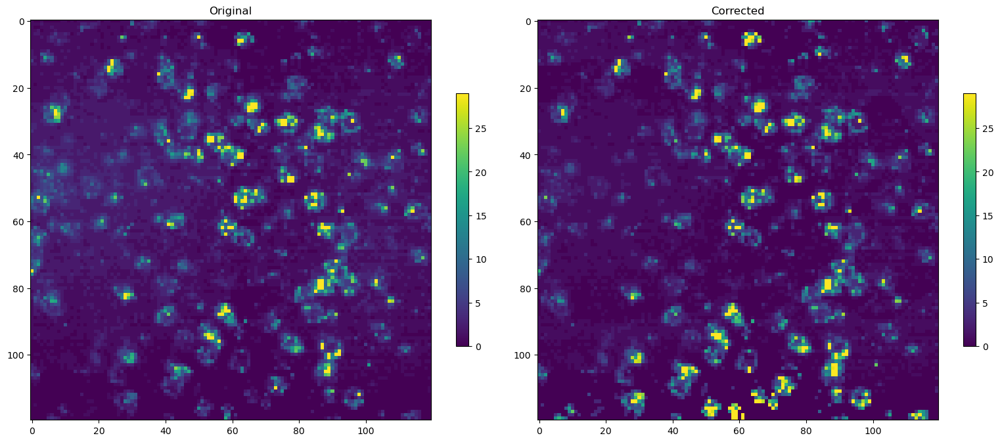

In [41]:
i = 100

vmin = np.percentile(images_transformed[i], 5)
vmax = np.percentile(images_transformed[i], 99)

fig, axes = plt.subplots(1, 2, figsize=(16,8))
im = axes[0].imshow(images[i], vmin=vmin, vmax=vmax)
fig.colorbar(im, ax=axes[0], shrink=0.5)
axes[0].set_title("Original")
im = axes[1].imshow(images_transformed[i], vmin=vmin, vmax=vmax)
fig.colorbar(im, ax=axes[1], shrink=0.5)
axes[1].set_title("Corrected")
fig.tight_layout()

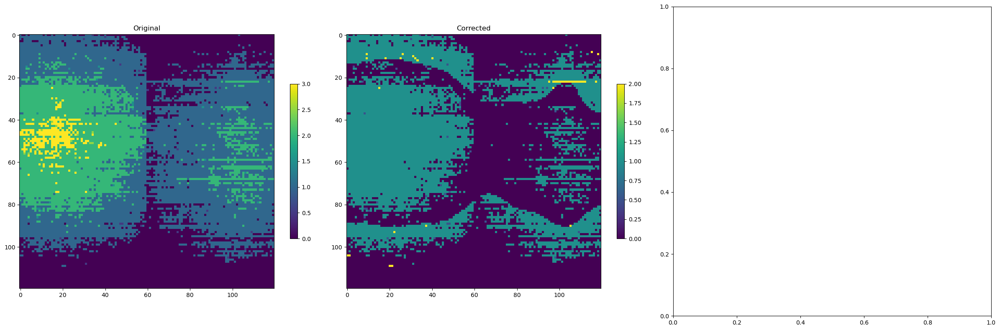

In [42]:
i = 50

vmin = np.percentile(images_transformed, 5)
vmax = np.percentile(images_transformed, 99)

fig, axes = plt.subplots(1, 3, figsize=(8*3,8))
im = axes[0].imshow(np.median(images, axis=0)) #, vmin=90, vmax=94)#, vmin=vmin, vmax=vmax)
fig.colorbar(im, ax=axes[0], shrink=0.5)
axes[0].set_title("Original")
im = axes[1].imshow(np.median(images_transformed, axis=0)) # , vmin=90, vmax=94) #, vmin=vmin, vmax=vmax)
fig.colorbar(im, ax=axes[1], shrink=0.5)
axes[1].set_title("Corrected")

# im = axes[2].imshow(np.median(images_transformed-images, axis=0)) # -np.max(images, axis=0))
# fig.colorbar(im, ax=axes[2], shrink=0.5)
# axes[2].set_title("Diff")
fig.tight_layout()

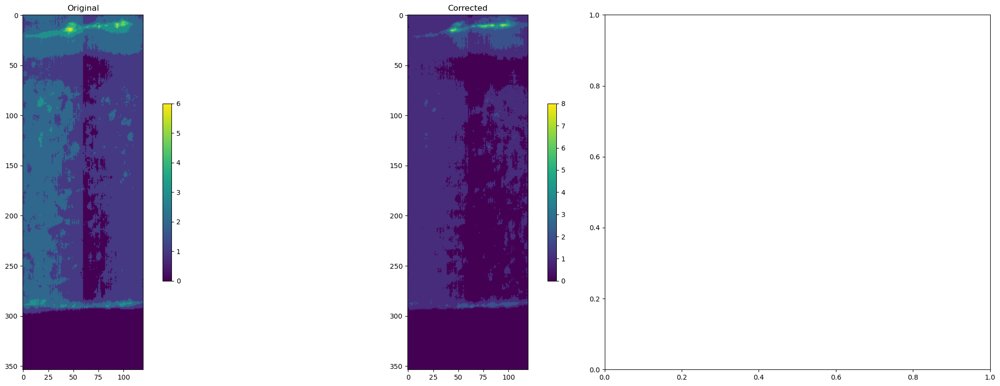

In [43]:

vmin = np.percentile(images_transformed, 5)
vmax = np.percentile(images_transformed, 99)

fig, axes = plt.subplots(1, 3, figsize=(8*3,8))
im = axes[0].imshow(np.median(images, axis=1)) #, vmin=90, vmax=95)#, vmin=vmin, vmax=vmax)
fig.colorbar(im, ax=axes[0], shrink=0.5)
axes[0].set_title("Original")
im = axes[1].imshow(np.median(images_transformed, axis=1)) # , vmin=90, vmax=95) #, vmin=vmin, vmax=vmax)
fig.colorbar(im, ax=axes[1], shrink=0.5)
axes[1].set_title("Corrected")

# im = axes[2].imshow(np.median(images_transformed-images, axis=1)) # -np.max(images, axis=0))
# fig.colorbar(im, ax=axes[2], shrink=0.5)
# axes[2].set_title("Diff")
fig.tight_layout()

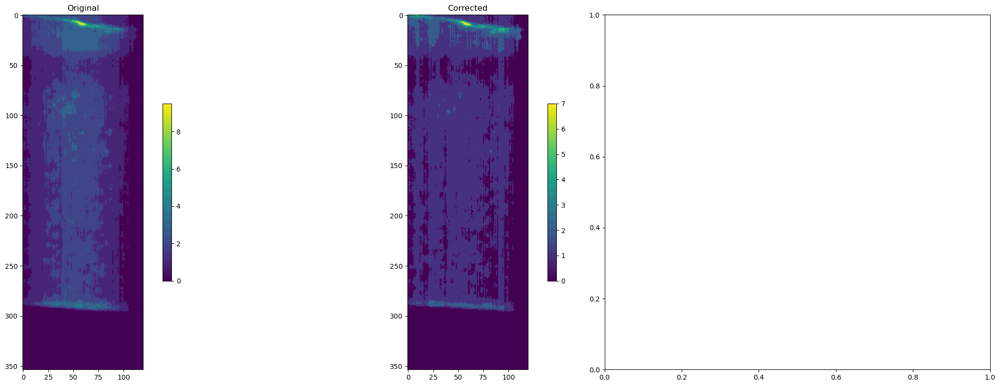

In [44]:
fig, axes = plt.subplots(1, 3, figsize=(8*3,8))
im = axes[0].imshow(np.median(images, axis=2)) #, vmin=90, vmax=95)#, vmin=vmin, vmax=vmax)
fig.colorbar(im, ax=axes[0], shrink=0.5)
axes[0].set_title("Original")
im = axes[1].imshow(np.median(images_transformed, axis=2)) # , vmin=90, vmax=95) #, vmin=vmin, vmax=vmax)
fig.colorbar(im, ax=axes[1], shrink=0.5)
axes[1].set_title("Corrected")

# im = axes[2].imshow(np.median(images_transformed-images, axis=1)) # -np.max(images, axis=0))
# fig.colorbar(im, ax=axes[2], shrink=0.5)
# axes[2].set_title("Diff")
fig.tight_layout()

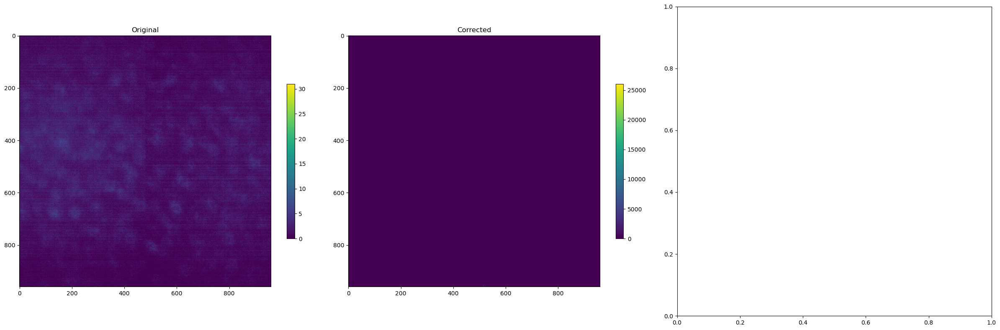

In [45]:
i = 50

vmin = np.percentile(images_transformed_s1, 5)
vmax = np.percentile(images_transformed_s1, 99)

fig, axes = plt.subplots(1, 3, figsize=(8*3,8))
im = axes[0].imshow(np.median(images_s1, axis=0)) #, vmin=90, vmax=94)#, vmin=vmin, vmax=vmax)
fig.colorbar(im, ax=axes[0], shrink=0.5)
axes[0].set_title("Original")
im = axes[1].imshow(np.median(images_transformed_s1, axis=0)) # , vmin=90, vmax=94) #, vmin=vmin, vmax=vmax)
fig.colorbar(im, ax=axes[1], shrink=0.5)
axes[1].set_title("Corrected")

# im = axes[2].imshow(np.median(images_transformed-images, axis=0)) # -np.max(images, axis=0))
# fig.colorbar(im, ax=axes[2], shrink=0.5)
# axes[2].set_title("Diff")
fig.tight_layout()

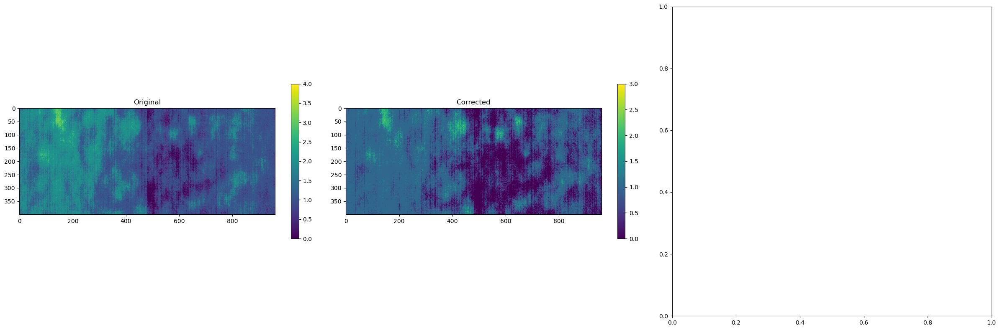

In [46]:

vmin = np.percentile(images_transformed_s1, 5)
vmax = np.percentile(images_transformed_s1, 99)

fig, axes = plt.subplots(1, 3, figsize=(8*3,8))
im = axes[0].imshow(np.median(images_s1, axis=1)) #, vmin=90, vmax=95)#, vmin=vmin, vmax=vmax)
fig.colorbar(im, ax=axes[0], shrink=0.5)
axes[0].set_title("Original")
im = axes[1].imshow(np.median(images_transformed_s1, axis=1)) # , vmin=90, vmax=95) #, vmin=vmin, vmax=vmax)
fig.colorbar(im, ax=axes[1], shrink=0.5)
axes[1].set_title("Corrected")

# im = axes[2].imshow(np.median(images_transformed-images, axis=1)) # -np.max(images, axis=0))
# fig.colorbar(im, ax=axes[2], shrink=0.5)
# axes[2].set_title("Diff")
fig.tight_layout()

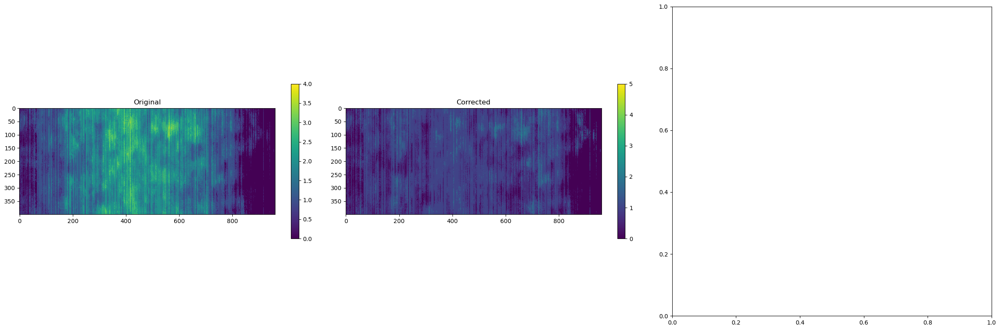

In [47]:
fig, axes = plt.subplots(1, 3, figsize=(8*3,8))
im = axes[0].imshow(np.median(images_s1, axis=2)) #, vmin=90, vmax=95)#, vmin=vmin, vmax=vmax)
fig.colorbar(im, ax=axes[0], shrink=0.5)
axes[0].set_title("Original")
im = axes[1].imshow(np.median(images_transformed_s1, axis=2)) # , vmin=90, vmax=95) #, vmin=vmin, vmax=vmax)
fig.colorbar(im, ax=axes[1], shrink=0.5)
axes[1].set_title("Corrected")

# im = axes[2].imshow(np.median(images_transformed-images, axis=1)) # -np.max(images, axis=0))
# fig.colorbar(im, ax=axes[2], shrink=0.5)
# axes[2].set_title("Diff")
fig.tight_layout()